In [1]:
import gymnasium as gym
import numpy as np
import matplotlib.pyplot as plt
import random
import copy

import imageio
import cv2
from IPython.display import Image

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F

from collections import deque


In [2]:
class ReplayBuffer:
    def __init__(self, capacity):
        self.capacity = capacity
        self.memory = deque(maxlen=capacity)

    def insert(self, state, action, reward, next_state):
        self.memory.append((state, action, reward, next_state))

    def sample(self, batch_size):
        return random.sample(self.memory, batch_size)

In [7]:
class ActorNet(nn.Module):
    def __init__(self, input_size, output_size):
        super(ActorNet, self).__init__()
        self.fc1 = nn.Linear(input_size, 64)
        self.relu1 = nn.ReLU()
        self.fc2 = nn.Linear(64,64)
        self.relu2 = nn.ReLU()
        self.fc3 = nn.Linear(64,output_size)
        self.t = nn.Tanh()

    def forward(self, x):
        x = self.relu1(self.fc1(x))
        x = self.relu2(self.fc2(x))
        x = self.t(self.fc3(x))
        return x

In [8]:
class CriticNet(nn.Module):
    def __init__(self, input_size, output_size):
        super(CriticNet, self).__init__()
        self.fc1 = nn.Linear(input_size, 64)
        self.relu1 = nn.ReLU()
        self.fc2 = nn.Linear(64,64)
        self.relu2 = nn.ReLU()
        self.fc3 = nn.Linear(64,output_size)
        
    def forward(self, a,b):
        x = torch.cat((a, b), dim=1)
        x = self.relu1(self.fc1(x))
        x = self.relu2(self.fc2(x))
        x = self.fc3(x)
        return x

In [24]:
class OUProcess:
    def __init__(self, dimension, theta=0.2, amplitude=0.5, mean=0.0, dt=1):
        self.dimension = dimension
        self.theta = theta
        self.amplitude = amplitude
        self.mean = mean
        self.dt = dt
        self.state = np.ones(self.dimension) * self.mean

    def reset(self):
        self.state = np.ones(self.dimension) * self.mean

    def sample(self):
        dw = np.random.normal(size=self.dimension)
        self.state +=  self.theta * (self.mean - self.state) * self.dt + self.amplitude * dw
        return self.state

#### Ornstein-Uhlenbeck Process Class

The `OUProcess` class represents a one-dimensional or multi-dimensional Ornstein-Uhlenbeck (OU) process, commonly used in stochastic processes and mathematical finance. The OU process is a mean-reverting stochastic process often employed to model the fluctuation of a variable around its long-term mean.

#### Initialization Parameters

- `dimension`: The number of dimensions for the OU process.
- `theta`: The rate at which the process reverts to its mean.
- `amplitude`: The amplitude of the random fluctuations.
- `mean`: The long-term mean towards which the process reverts.
- `dt`: The time step for the process.

#### Methods
`reset(self)`: Resets the state of the OU process to the initial mean.
`sample(self)`: Generates a random sample from the OU process, updating the internal state based on the OU process dynamics. Returns the current state of the process.


In [25]:
class GaussianNoise:
    def __init__(self, dimension, mean=0.0, std=0.8):
        self.dimension = dimension
        self.mean = mean
        self.std = std

    def sample(self):
        return np.random.normal(loc=self.mean, scale=self.std, size=(self.dimension))

In [40]:
class Agent:
    def __init__(self,env,gamma, batch_size):
        self.env = env
        self.state_size = env.observation_space.shape[0]
        self.action_size = env.action_space.shape[0]
        self.gamma = gamma
        self.replay_buffer = ReplayBuffer(5000)
        self.actor = ActorNet(self.state_size, self.action_size)
        self.actor_optimizer = optim.Adam(self.actor.parameters(), lr=0.0009)
        self.critic = CriticNet(self.state_size + self.action_size, 1)
        self.critic_optimizer = optim.Adam(self.critic.parameters(), lr=0.0009)
        
        self.target_actor = ActorNet(self.state_size, self.action_size).eval()
        self.target_critic = CriticNet(self.state_size + self.action_size, 1).eval()
        
        self.update_target_networks(tau = 1.0)  # Initialize target networks with the same weights
        self.batch_size = batch_size

    def update_target_networks(self, tau):
        for target_param, param in zip(self.target_actor.parameters(), self.actor.parameters()):
            target_param.data.copy_(copy.deepcopy(tau * param.data + (1.0 - tau) * target_param.data))

        for target_param, param in zip(self.target_critic.parameters(), self.critic.parameters()):
            target_param.data.copy_(copy.deepcopy(tau * param.data + (1.0 - tau) * target_param.data))

    def train(self,episodes,process):
        list_rewards = []
        list_actor_loss = []
        list_critic_loss = []
        
        for eps in range(1,episodes+1):
            if process == "ou":
                smpl = OUProcess(dimension = self.action_size)
            elif process == "gauss":
                smpl = GaussianNoise(dimension = self.action_size)
                
            state,_ = self.env.reset()
            terminal = False
            truncated = False
            avg_actor_loss = 0.0
            avg_critic_loss = 0.0
            avg_rewards = 0.0
            count = 0
            while not (terminal or truncated):
                action = self.actor(torch.tensor(state, dtype=torch.float32)).clone().detach().numpy() + smpl.sample()
                next_state, reward, terminal,truncated,_ = self.env.step(action)
                avg_rewards += reward
                self.replay_buffer.insert(state, action, reward, next_state)

                # Sample a random minibatch of transitions
                if len(self.replay_buffer.memory) >= self.batch_size:
                    batch = self.replay_buffer.sample(self.batch_size)
                    states, actions, rewards, next_states = zip(*batch)
                    
                    states = torch.tensor(np.array(states), dtype=torch.float32)
                    actions = torch.tensor(np.vstack(actions), dtype=torch.float32) # actions already numpy
                    rewards = torch.tensor(np.array(rewards), dtype=torch.float32)
                    next_states = torch.tensor(np.array(next_states), dtype=torch.float32)
                    
                    # Compute SARSA target values
                    with torch.no_grad():
                        target_actions = self.target_actor(next_states)
                        target_values = self.target_critic(next_states,target_actions)
                        targets = rewards.unsqueeze(1) + self.gamma * target_values
                        
                    # Update critic by minimizing MSE loss
                    predicted_values = self.critic(states,actions)
                    critic_loss = F.mse_loss(predicted_values, targets)
                    self.critic_optimizer.zero_grad()
                    critic_loss.backward()
                    self.critic_optimizer.step()
                    avg_critic_loss += critic_loss.item()

                    # Update actor using sampled deterministic policy gradient
                    actor_actions = self.actor(states)
                    actor_loss = -torch.mean(self.critic(states, actor_actions))
                    self.actor_optimizer.zero_grad()
                    actor_loss.backward()
                    self.actor_optimizer.step()
                    avg_actor_loss += actor_loss.item()

                    # Perform soft updates
                    count += 1
                    self.update_target_networks(tau=0.01)
                state = next_state
            if eps%10 == 0 :
                print("avg_rewards:",avg_rewards," critic_loss:",avg_critic_loss/count," actor_loss",avg_actor_loss/count)
            list_rewards.append(avg_rewards)
            list_critic_loss.append(avg_critic_loss/count)
            list_actor_loss.append(avg_actor_loss/count)          
        return list_rewards,list_actor_loss,list_critic_loss 


#### Reinforcement Learning Agent Class

The `Agent` class implements a reinforcement learning agent using an actor-critic architecture with experience replay. The agent is designed to interact with an environment and learn a policy that maximizes cumulative rewards.

#### Initialization Parameters

- `env`: The environment with which the agent interacts.
- `gamma`: The discount factor for future rewards.
- `batch_size`: The size of the minibatch for experience replay.

#### Neural Networks

- `actor`: The actor neural network responsible for policy approximation.
- `critic`: The critic neural network responsible for estimating the value function.

#### Target Networks

- `target_actor`: Target network for the actor, used for stability during training.
- `target_critic`: Target network for the critic, used for stability during training.

#### Methods

- `update_target_networks(self, tau)`: Updates the target networks using a soft update strategy with a specified `tau` parameter.
- `train(self, episodes, process)`: Trains the agent for a specified number of episodes using either Ornstein-Uhlenbeck (OU) or Gaussian noise for exploration.

#### Key Training Steps
1. **`Environment Interaction:`** The agent interacts with the environment, collecting experiences in the replay buffer.
2. **`Experience Replay:`** Random minibatches of transitions are sampled from the replay buffer for training.
3. **`Critic Update:`** The critic neural network is updated to minimize the mean squared error between predicted and target values.
4. **`Actor Update:`** The actor neural network is updated using the sampled deterministic policy gradient.
5. **`Soft Updates:`** Target networks are updated using a soft update strategy for increased stability.


In [8]:
def run_testing_and_create_gif(agent,gif_path='testing.gif',frame_duration=0.05):
    state,_ = agent.env.reset()
    terminated = False
    truncated = False
    frames = []
    total_reward = 0
    count = 0
    while not (terminated or truncated):
        action = agent.actor(torch.tensor(state, dtype=torch.float32)).clone().detach().numpy() 
        next_state, reward, terminal,truncated,_ = agent.env.step(action)
        total_reward += reward
        state = next_state
        frames.append(agent.env.render())
        count += 1

    print("total_reward: ",total_reward,"count :",count)
    imageio.mimsave(gif_path,frames,duration=frame_duration)

In [37]:
env1 = gym.make('MountainCarContinuous-v0',render_mode = 'rgb_array')
input_size = env1.observation_space.shape[0]
output_size = env1.action_space.shape[0]
print("input size ",input_size," ,","output size",output_size)

batch_size = 64
agent = Agent(env1, 0.9999, batch_size)

input size  2  , output size 1


In [10]:
rewards,actor_losses,critic_losses = agent.train(episodes = 200,process = "ou")

avg_rewards: -24.496710536609616  critic_loss: 1.808355982063494e-06  actor_loss -0.22098028912949255
avg_rewards: -196.29994449211168  critic_loss: 1.8732664643012378  actor_loss -1.122441125584317
avg_rewards: -134.15192330998315  critic_loss: 14.645251003829566  actor_loss -33.155554114638626
avg_rewards: 94.00657585240505  critic_loss: 56.59189196268717  actor_loss -83.63128631591798
avg_rewards: 89.5342678979799  critic_loss: 84.60278038129415  actor_loss -146.21943936282642
avg_rewards: 94.27610229306131  critic_loss: 107.56914407434599  actor_loss -228.5864219128246
avg_rewards: 94.66599054137407  critic_loss: 228.26217031478882  actor_loss -328.06303787231445
avg_rewards: 94.06971121527144  critic_loss: 347.36346048704337  actor_loss -482.3162424866582
avg_rewards: 94.01782312269177  critic_loss: 413.1955391565959  actor_loss -659.1689631144205
avg_rewards: 92.89382258655752  critic_loss: 549.4097120729211  actor_loss -914.0348418771404
avg_rewards: 55.439323308845275  critic_l

<p> we can see the model gets trained here actor_loss is the the -J(theta) as we are trying to do gradiet ascent</p>

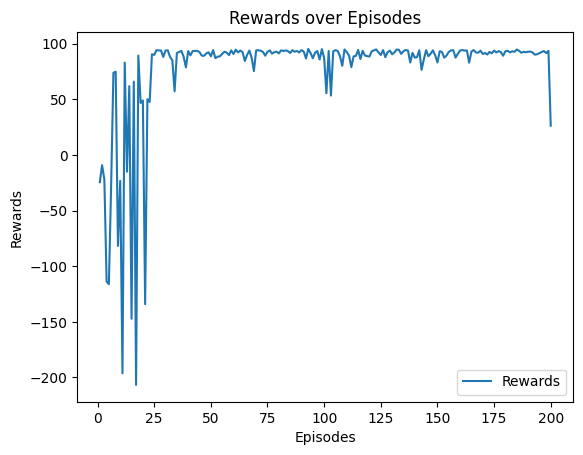

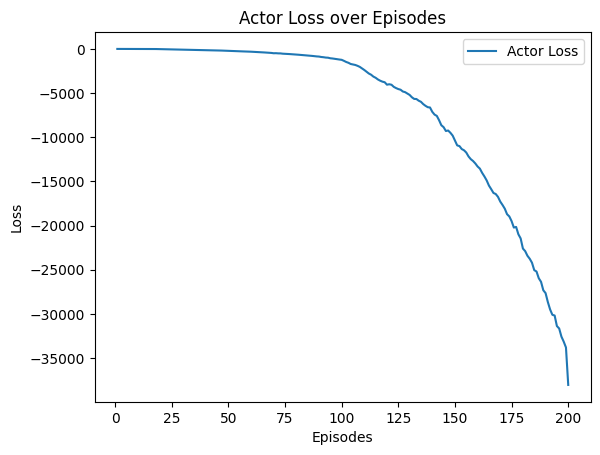

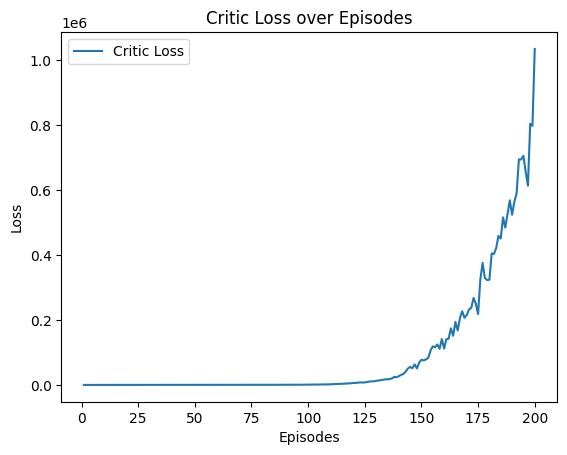

In [11]:
episodes = np.array(range(1,200 + 1))

plt.plot(episodes, rewards, label='Rewards')
plt.title('Rewards over Episodes')
plt.xlabel('Episodes')
plt.ylabel('Rewards')
plt.legend()
plt.show()

plt.plot(episodes, actor_losses, label='Actor Loss')
plt.title('Actor Loss over Episodes')
plt.xlabel('Episodes')
plt.ylabel('Loss')
plt.legend()
plt.show()

plt.plot(episodes, critic_losses, label='Critic Loss')
plt.title('Critic Loss over Episodes')
plt.xlabel('Episodes')
plt.ylabel('Loss')
plt.legend()
plt.show()

total_reward:  92900.49072618446 count : 999


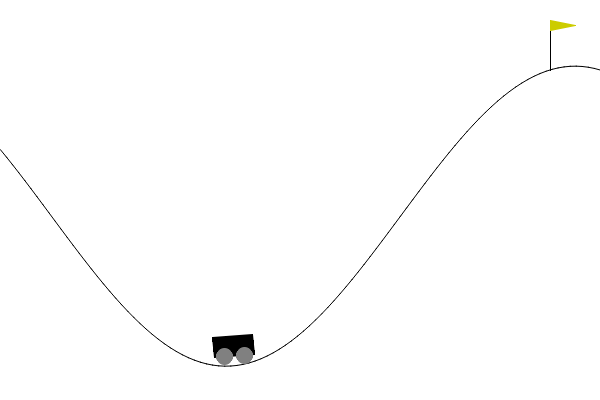

In [12]:
run_testing_and_create_gif(agent,gif_path='testing.gif',frame_duration=0.05)
display(Image(filename='testing.gif'))

### Train the Agent with DDPG gauss noise

In [38]:
rewards_gauss,actor_losses_gauss,critic_losses_gauss = agent.train(episodes = 200,process = "gauss")

avg_rewards: -99.63012912825789  critic_loss: 1.4956564535503611e-05  actor_loss -0.03631776062076216
avg_rewards: -98.14579549516353  critic_loss: 1.1509850710754509e-05  actor_loss -0.146627353192927
avg_rewards: -103.79728036997396  critic_loss: 1.0783606410706863  actor_loss -0.42560338296809114
avg_rewards: 56.80471752359228  critic_loss: 2.1848088232071503  actor_loss -5.869205457231272
avg_rewards: 66.84548204619975  critic_loss: 15.552980395023432  actor_loss -21.804129842984473
avg_rewards: 51.0309185435757  critic_loss: 43.207305657409876  actor_loss -107.24234272781953
avg_rewards: 75.01527885259551  critic_loss: 170.96670118478627  actor_loss -263.09281381460335
avg_rewards: 67.82787610477754  critic_loss: 367.73064812369967  actor_loss -501.3638735232146
avg_rewards: 74.9578852155465  critic_loss: 999.6050116356383  actor_loss -963.1964812583112
avg_rewards: 76.28448695962754  critic_loss: 2380.2711074935805  actor_loss -1585.7707391485467
avg_rewards: 73.19824279371743  c

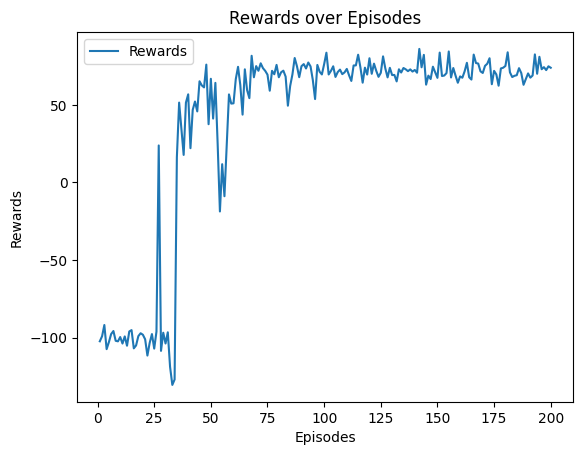

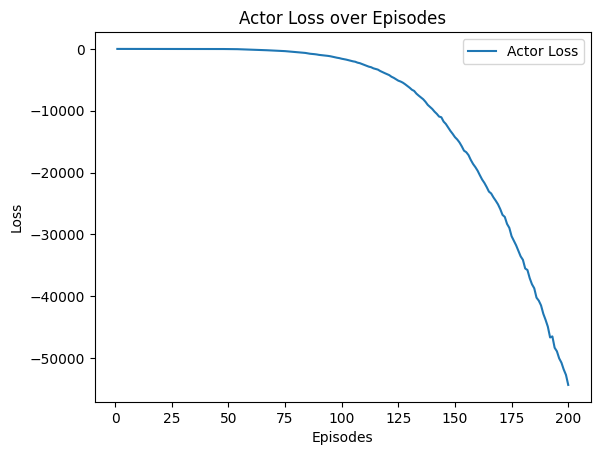

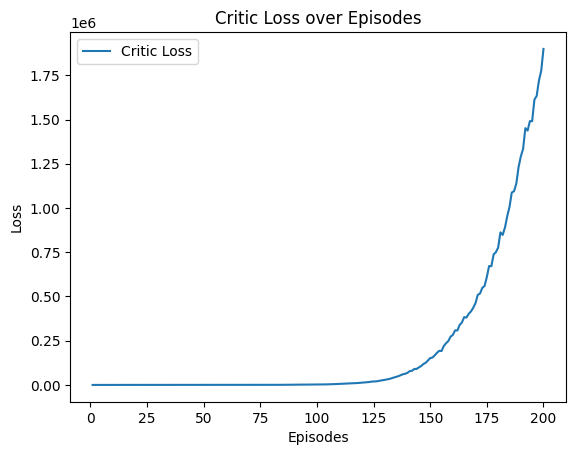

In [39]:
episodes = np.array(range(1,200 + 1))

plt.plot(episodes, rewards_gauss, label='Rewards')
plt.title('Rewards over Episodes')
plt.xlabel('Episodes')
plt.ylabel('Rewards')
plt.legend()
plt.show()

plt.plot(episodes, actor_losses_gauss, label='Actor Loss')
plt.title('Actor Loss over Episodes')
plt.xlabel('Episodes')
plt.ylabel('Loss')
plt.legend()
plt.show()

plt.plot(episodes, critic_losses_gauss, label='Critic Loss')
plt.title('Critic Loss over Episodes')
plt.xlabel('Episodes')
plt.ylabel('Loss')
plt.legend()
plt.show()

total_reward:  92900.24238050958 count : 999


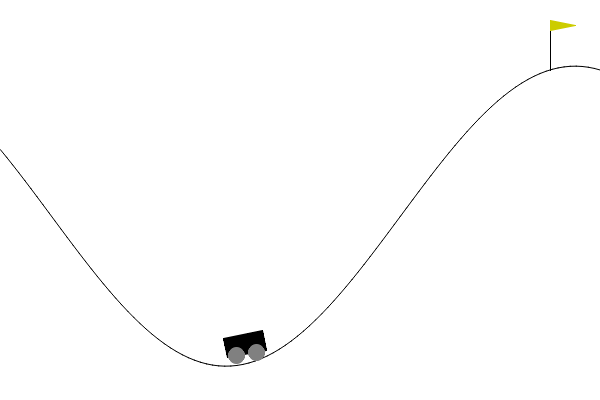

In [40]:
run_testing_and_create_gif(agent,gif_path='testing1.gif',frame_duration=0.05)
display(Image(filename='testing1.gif'))

We can see ou process converges faster around 25 we reaches the desired value but in gauss we reached we reached at 75 we can understand this by examining the sample equation $$ self.state +=  self.theta * (self.mean - self.state) * self.dt + self.amplitude * dw $$ subtituing the values which we took in this we get
$ state = 0.8*state + 0.5*np-random-normal $ now initially we start with state as $0$ so essentially we have 
$$ state_n = (0.5*np-random-normal)^n $$ 
<p>essentially we are multiplying the noise with 0.5 and taking it to the power n so we know adding noise is like exploring the neighbourhood but as the network gets trained we want this exploration to be less this can be achieved by Ornstein Ulhenbeck process as it is a markov process it takes into account the previous state and the current state and the noise is added to the previous state so it is like a random walk in the neighbourhood of the previous state so it is more likely to explore the neighbourhood of the previous state and as the network gets trained the previous state is more likely to be the desired state so it is more likely to explore the neighbourhood of the desired state and hence we converge faster, in case of gauss we just add noise even when network is trained enough and should explore less and concentrate on exploitation</p> 

## Lunar Lander

In [41]:
env2 = gym.make('LunarLanderContinuous-v2')
input_size = env2.observation_space.shape[0]
output_size = env2.action_space.shape[0]
print(input_size," ,",output_size)

batch_size = 64
agent1 = Agent(env2, 0.99, batch_size)

8  , 2


In [42]:
rewards,actor_losses,critic_losses = agent1.train(episodes = 200,process = "ou") # lr = 0.0009

avg_rewards: -180.20531146579725  critic_loss: 66.11573147051263  actor_loss 17.491263591881953
avg_rewards: -49.91877506307839  critic_loss: 28.43358081972599  actor_loss -37.74210589599609
avg_rewards: -54.95041230280144  critic_loss: 21.80379837977886  actor_loss -64.4365790939331
avg_rewards: 37.2105689950946  critic_loss: 12.9527719039917  actor_loss -84.60558973693847
avg_rewards: -75.70296277463197  critic_loss: 18.873348415362372  actor_loss -97.33923508284929
avg_rewards: -167.58042512492023  critic_loss: 28.422397968780935  actor_loss -98.44124087053746
avg_rewards: -359.4973759016074  critic_loss: 509.8446454570792  actor_loss -101.08164551298498
avg_rewards: -153.45316050759166  critic_loss: 895.0529375505877  actor_loss -105.83829993170662
avg_rewards: -146.79540593094484  critic_loss: 302.8512992090827  actor_loss -107.42137780925572
avg_rewards: -380.8974444146738  critic_loss: 188.69160645872682  actor_loss -119.28722348055997
avg_rewards: -73.73553161722324  critic_los

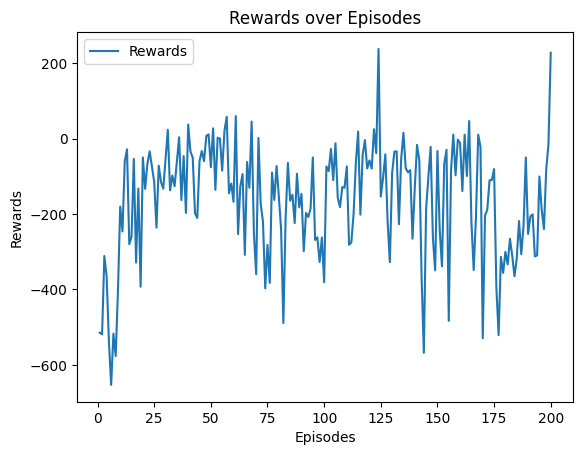

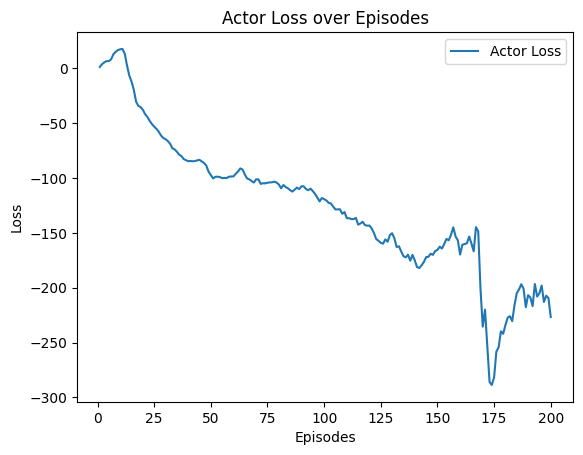

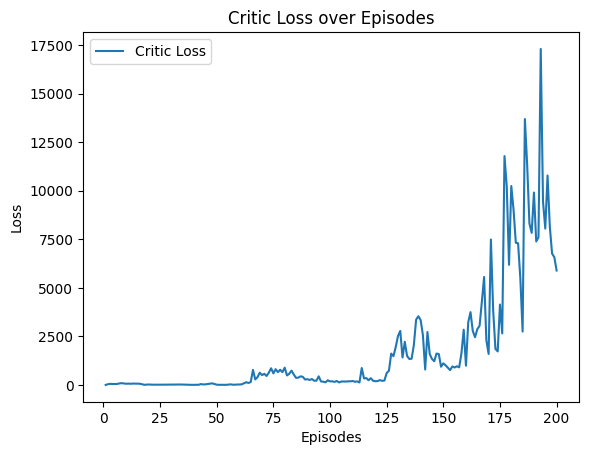

In [43]:
episodes = np.array(range(1,200 + 1))

plt.plot(episodes, rewards, label='Rewards')
plt.title('Rewards over Episodes')
plt.xlabel('Episodes')
plt.ylabel('Rewards')
plt.legend()
plt.show()

plt.plot(episodes, actor_losses, label='Actor Loss')
plt.title('Actor Loss over Episodes')
plt.xlabel('Episodes')
plt.ylabel('Loss')
plt.legend()
plt.show()

plt.plot(episodes, critic_losses, label='Critic Loss')
plt.title('Critic Loss over Episodes')
plt.xlabel('Episodes')
plt.ylabel('Loss')
plt.legend()
plt.show()

total_reward:  2990.4340854339453 count : 1000
1000


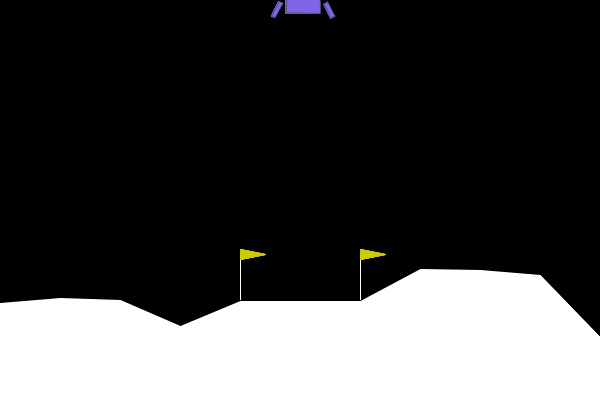

In [45]:
env3 = gym.make('LunarLanderContinuous-v2',render_mode = 'rgb_array')
state, _ = env3.reset()
terminated = False
truncated = False
frames = []
total_reward = 0
count = 0
while not (terminated or truncated):
    action = agent1.actor(torch.tensor(state, dtype=torch.float32)).clone().detach().numpy() 
    next_state, reward, terminal,truncated,_ = env3.step(action)
    total_reward += reward
    state = next_state
    frames.append(env3.render())
    count += 1
env3.close()

print("total_reward: ",total_reward,"count :",count)
print(len(frames))
imageio.mimsave('testing3.gif',frames,duration=0.05)
display(Image(filename='testing3.gif'))

In [22]:
rewards1,actor_losses1,critic_losses1 = agent1.train(episodes = 200,process = "gauss")

avg_rewards: -259.99655616431323  critic_loss: 124.28271520944466  actor_loss 0.49051438933028313
avg_rewards: -384.3031332826696  critic_loss: 527.7451416522781  actor_loss 0.1484083075054808
avg_rewards: -50.42990496613334  critic_loss: 472.62993299484253  actor_loss 11.660246005058289
avg_rewards: -32.55581440511153  critic_loss: 46.3263574256897  actor_loss -157.50946908569335
avg_rewards: -206.9872689216468  critic_loss: 4.799911851167679  actor_loss -119.54435132598877
avg_rewards: -176.48175236444558  critic_loss: 57.80142373490334  actor_loss -64.41190731430054
avg_rewards: -228.3444402952795  critic_loss: 78.73992092300344  actor_loss -54.4341259709111
avg_rewards: -242.73923563354288  critic_loss: 18.815278105460774  actor_loss -52.27866882889941
avg_rewards: -136.58503576399022  critic_loss: 22.26407542754346  actor_loss -57.95462857644389
avg_rewards: -166.94775175156033  critic_loss: 11.64839881692229  actor_loss -58.848851586465784
avg_rewards: -188.75471028167868  critic

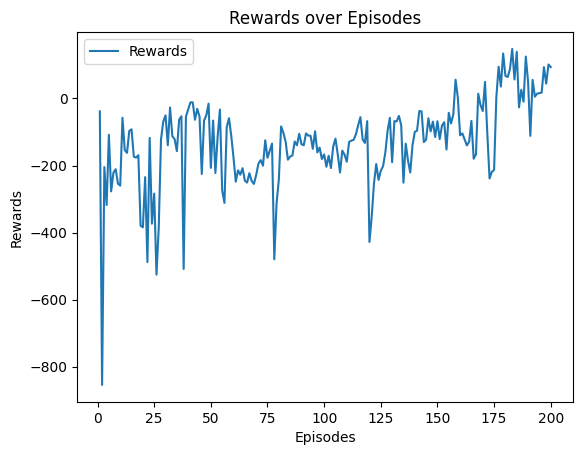

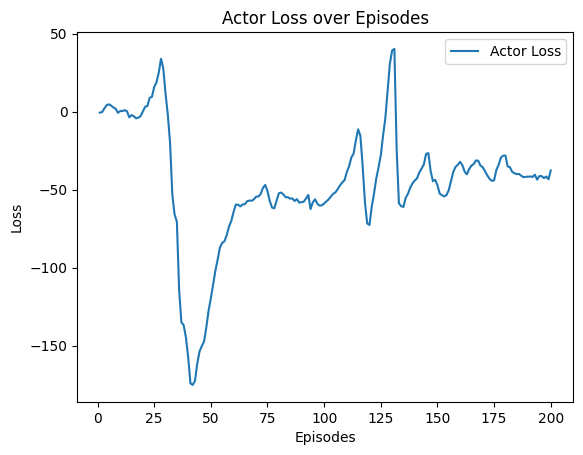

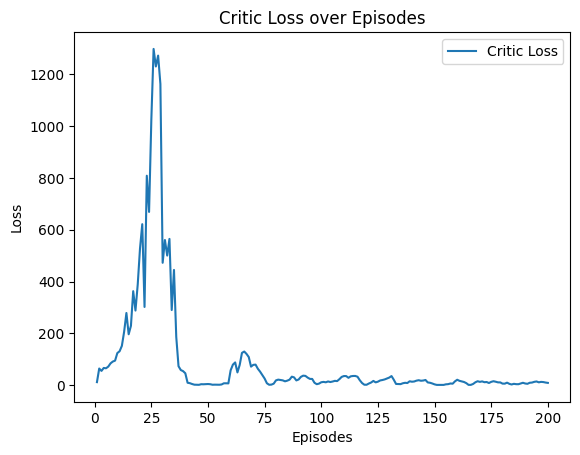

In [23]:
episodes = np.array(range(1,200 + 1))

plt.plot(episodes, rewards1, label='Rewards')
plt.title('Rewards over Episodes')
plt.xlabel('Episodes')
plt.ylabel('Rewards')
plt.legend()
plt.show()

plt.plot(episodes, actor_losses1, label='Actor Loss')
plt.title('Actor Loss over Episodes')
plt.xlabel('Episodes')
plt.ylabel('Loss')
plt.legend()
plt.show()

plt.plot(episodes, critic_losses1, label='Critic Loss')
plt.title('Critic Loss over Episodes')
plt.xlabel('Episodes')
plt.ylabel('Loss')
plt.legend()
plt.show()

total_reward:  956.8546695685768 count : 1000
1000


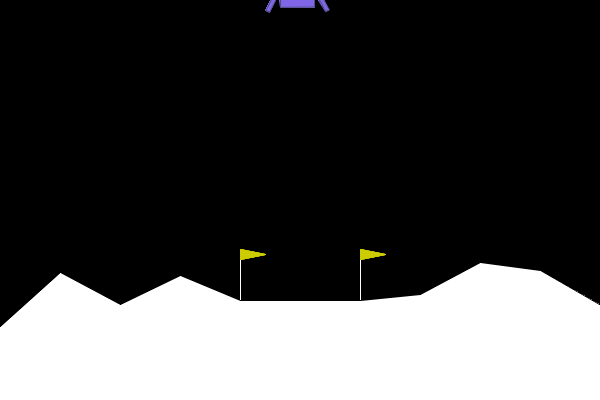

In [25]:
env3 = gym.make('LunarLanderContinuous-v2',render_mode = 'rgb_array')
state, _ = env3.reset()
terminated = False
truncated = False
frames = []
total_reward = 0
count = 0
while not (terminated or truncated):
    action = agent1.actor(torch.tensor(state, dtype=torch.float32)).clone().detach().numpy() 
    next_state, reward, terminal,truncated,_ = env3.step(action)
    total_reward += reward
    state = next_state
    frames.append(env3.render())
    count += 1
env3.close()

print("total_reward: ",total_reward,"count :",count)
print(len(frames))
imageio.mimsave('testing1.gif',frames,duration=0.05)
display(Image(filename='testing1.gif'))

in this case we see gauss converges better cause eventhough Ornstein Ulhenbeck is more generalised it is difficult to tune the hyperparameters as there are 4 hyperparamertes to tune for and there is no fixed set of values that gives best values depending on the problem we have to tune them some times we explore more than needed or in other cases we explore less than needed so it is difficult to tune the hyperparameters and strike a balace between exploration and exploitation but in case of gauss we just have one hyperparameter to tune and it is easy to tune it and we can see it converges better than Ornstein Ulhenbeck